In [ ]:
import anndata
import torch
import stPlus
import os
import random
import warnings
import pickle

import squidpy as sq
import numpy as np
import scanpy as sc
import pandas as pd
import spatialdm as sdm

from sklearn.model_selection import KFold
from matplotlib import pyplot as plt
from transpa.eval_util import calc_corr
from transpa.util import expTransImp, leiden_cluster, compute_autocorr, plot_genes
from benchmark import SpaGE_impute, Tangram_impute
from exp_spatialdm import spatialdm


warnings.filterwarnings('ignore')
pre_datapaths = ["../../output/preprocessed_dataset/seqFISH_single_cell.pkl",
                 "../../output/preprocessed_dataset/merfish_moffit.pkl",
                 "../../output/preprocessed_dataset/osmFISH_allenvisp.pkl",
                 "../../output/preprocessed_dataset/starmap_allenvisp.pkl"
                 ]

seed = 10
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

In [2]:
pre_datapath = pre_datapaths[0]
with open(pre_datapath, 'rb') as infile:
    spa_adata, scrna_adata, raw_spatial_df, raw_scrna_df, raw_shared_gene = pickle.load(infile)
    cls_key = 'leiden'
    classes = scrna_adata.obs[cls_key]
    ct_list = np.unique(classes)

In [3]:
sc.pp.highly_variable_genes(scrna_adata, n_top_genes=1000)
scrna_adata

AnnData object with n_obs × n_vars = 32844 × 29452
    obs: 'cell', 'barcode', 'sample', 'pool', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'sizeFactor', 'leiden'
    var: 'ENSEMBL', 'SYMBOL', 'SymbolUniq', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [4]:
test_genes = np.setdiff1d(scrna_adata.var_names[scrna_adata.var['highly_variable']], raw_shared_gene)
n_valid_hc_sc_genes = len(test_genes)
print(len(test_genes), " valid hv sc genes")
np.random.seed(42)
test_genes = np.setdiff1d(np.union1d(test_genes, np.random.choice(scrna_adata.var_names, 1000, replace=False)), raw_shared_gene)
# test_genes = np.setdiff1d(np.random.choice(scrna_adata.var_names, 2000, replace=False), raw_shared_gene)
len(test_genes)

802  valid hv sc genes


1754

In [5]:
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics.pairwise import cosine_similarity
nnb = NearestNeighbors(n_neighbors=15, n_jobs=20)
sc.pp.pca(scrna_adata)
nnb.fit(scrna_adata.obsm['X_pca'])
rna_nb_idx = nnb.kneighbors(scrna_adata.obsm['X_pca'], return_distance=False)
res = expTransImp(
        df_ref=raw_scrna_df,
        df_tgt=raw_spatial_df,
        train_gene=raw_shared_gene,
        test_gene=np.concatenate([raw_shared_gene, test_genes]),
        n_simulation=200,
        signature_mode='cell',
        mapping_mode='lowrank',
        classes=classes,
        n_epochs=2000,
        seed=seed,
        device=device)

[TransImp] Epoch: 2000/2000, loss: 0.781033, (IMP) 0.781033: 100%|██████████| 2000/2000 [00:33<00:00, 59.80it/s]


In [6]:
spa_adata

AnnData object with n_obs × n_vars = 57536 × 351
    obs: 'uniqueID', 'embryo', 'pos', 'z', 'x_global', 'y_global', 'x_global_affine', 'y_global_affine', 'embryo_pos', 'embryo_pos_z', 'Area', 'UMAP1', 'UMAP2', 'celltype_mapped_refined', 'segmentation_vertices_x_global_affine', 'segmentation_vertices_y_global_affine'
    uns: 'log1p', 'spatial_neighbors'
    obsm: 'spatial'
    layers: 'normalized'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [7]:
imp_adata = sc.AnnData(res[0])
imp_adata.var_names = np.concatenate([raw_shared_gene, test_genes])
imp_adata.obs = spa_adata.obs.copy()
imp_adata.obsm = spa_adata.obsm
imp_adata.obsp = spa_adata.obsp

In [8]:
sq.gr.spatial_autocorr(
    imp_adata,
    n_jobs=10,
)

In [9]:
imp_adata

AnnData object with n_obs × n_vars = 57536 × 2105
    obs: 'uniqueID', 'embryo', 'pos', 'z', 'x_global', 'y_global', 'x_global_affine', 'y_global_affine', 'embryo_pos', 'embryo_pos_z', 'Area', 'UMAP1', 'UMAP2', 'celltype_mapped_refined', 'segmentation_vertices_x_global_affine', 'segmentation_vertices_y_global_affine'
    uns: 'moranI'
    obsm: 'spatial'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [10]:
df_var = pd.DataFrame(res[1], index=np.concatenate([raw_shared_gene, test_genes]), columns=['pred_var'])
df_var.sort_values(axis=0, by='pred_var', ascending=True)

,pred_var
Rplp0,0.498202
Rpl13,0.498263
Rps27a,0.498334
Rps6,0.498363
Rps14,0.498369
...,...
Olfr1066,0.500179
Olfr1009,0.500179
Obp1b,0.500179
Exosc6,0.500179


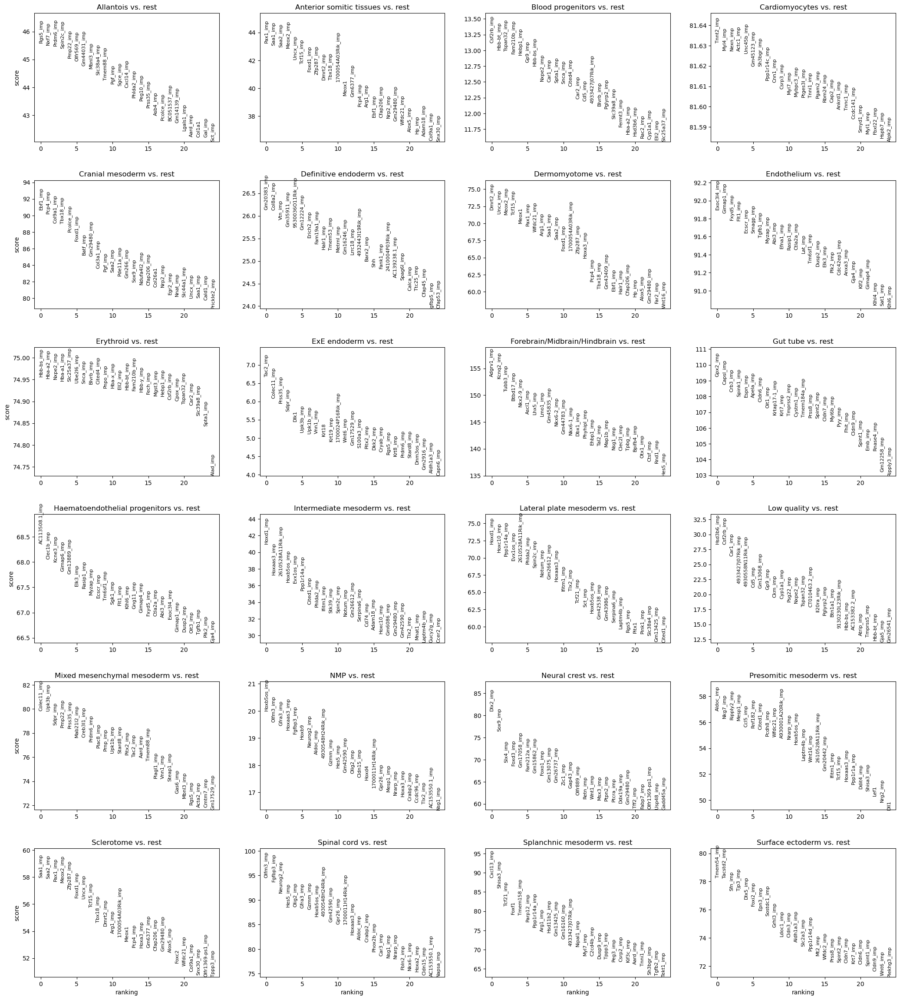

In [11]:
merged_adata = sc.AnnData(np.hstack([res[0][:, len(raw_shared_gene):], spa_adata.X.toarray()]))
merged_adata.var_names = np.concatenate([[f'{g}_imp' for g in test_genes], spa_adata.var_names])
merged_adata.obs = spa_adata.obs.copy()
merged_adata.obsm = spa_adata.obsm
merged_adata.obsp = spa_adata.obsp
sc.tl.rank_genes_groups(merged_adata, 'celltype_mapped_refined', method='wilcoxon')
sc.pl.rank_genes_groups(merged_adata, n_genes=25, sharey=False)

In [12]:
sc.tl.rank_genes_groups(imp_adata, 'celltype_mapped_refined', method='wilcoxon')
# sc.pl.rank_genes_groups(imp_adata, n_genes=25, sharey=False)

In [13]:
merged_adata

AnnData object with n_obs × n_vars = 57536 × 2105
    obs: 'uniqueID', 'embryo', 'pos', 'z', 'x_global', 'y_global', 'x_global_affine', 'y_global_affine', 'embryo_pos', 'embryo_pos_z', 'Area', 'UMAP1', 'UMAP2', 'celltype_mapped_refined', 'segmentation_vertices_x_global_affine', 'segmentation_vertices_y_global_affine'
    uns: 'rank_genes_groups'
    obsm: 'spatial'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [14]:
sq.gr.spatial_autocorr(
    merged_adata,
    n_jobs=10,
)


In [15]:
spatialdm(imp_adata, "mouse", 0.05)    

140 140
(134, 9)


In [16]:
spatialdm(spa_adata, "mouse", 0.05) 

64 64
(59, 7)


In [17]:
merged_adata2 = sc.AnnData(np.hstack([res[0][:, len(raw_shared_gene):], spa_adata.X.toarray()]))
merged_adata2.var_names = np.concatenate([[f'{g}' for g in test_genes], spa_adata.var_names])
merged_adata2.obs = spa_adata.obs.copy()
merged_adata2.obsm = spa_adata.obsm
merged_adata2.obsp = spa_adata.obsp
sq.gr.spatial_autocorr(
    merged_adata2,
    n_jobs=10,
)
spatialdm(merged_adata2, "mouse", 0.05) 

140 140
(134, 9)


In [18]:
unprobed_pairs = np.setdiff1d(merged_adata2.uns['global_res'].index, spa_adata.uns['global_res'].index)
print(unprobed_pairs.shape)
merged_adata2.uns['global_res'].loc[unprobed_pairs].sort_values(by=['fdr']).iloc[:20]

(75,)


,Ligand0,Receptor0,Receptor1,z_pval,z,fdr,selected,global_I,perm_pval
FGF16_FGFR2,Fgf16,Fgfr2,None,0.000000e+00,51.721179,0.000000e+00,True,0.033523,NaN
FN1_ITGA3_ITGB1,Fn1,Itga3,None,0.000000e+00,68.178572,0.000000e+00,True,0.110813,NaN
SST_SSTR5,Sst,Sstr5,None,0.000000e+00,162.820616,0.000000e+00,True,0.105532,NaN
TGFB1_TGFBR1_TGFBR2,Tgfb1,Tgfbr2,None,0.000000e+00,251.137400,0.000000e+00,True,0.162774,NaN
FGF16_FGFR4,Fgf16,Fgfr4,None,0.000000e+00,122.026547,0.000000e+00,True,0.079091,NaN
TGFB1_ACVR1B_TGFBR2,Tgfb1,Tgfbr2,None,0.000000e+00,251.137400,0.000000e+00,True,0.162774,NaN
WNT16_FZD2_LRP5,Wnt16,Fzd2,None,0.000000e+00,69.180629,0.000000e+00,True,0.044839,NaN
EFNA1_EPHA1,Efna1,Epha1,None,0.000000e+00,110.741893,0.000000e+00,True,0.179992,NaN
WNT16_FZD2_LRP6,Wnt16,Fzd2,None,0.000000e+00,69.180629,0.000000e+00,True,0.044839,NaN
FN1_ITGA5_ITGB1,Fn1,Itga5,None,0.000000e+00,222.201663,0.000000e+00,True,0.361151,NaN


               I  pval_norm  var_norm  pval_norm_fdr_bh
Tgfb1   0.269328        0.0  0.000006               NaN
Tgfbr2  0.217147        0.0  0.000006               NaN


<Figure size 7600x7600 with 0 Axes>

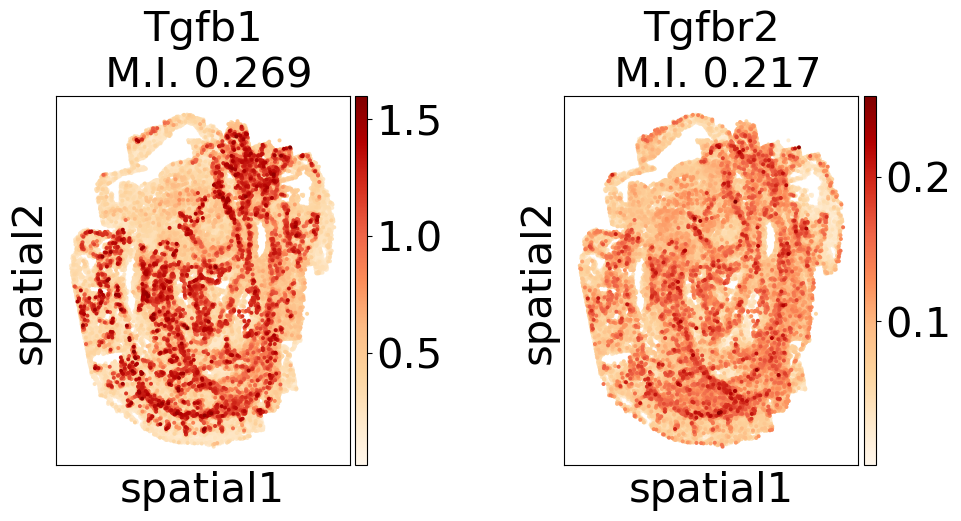

In [19]:
plot_genes(['Tgfb1','Tgfbr2'], merged_adata2, is_I=True)

              I  pval_norm  var_norm  pval_norm_fdr_bh
Fgf16  0.285242        0.0  0.000006               NaN
Fgfr2  0.134534        0.0  0.000006               NaN


<Figure size 7600x7600 with 0 Axes>

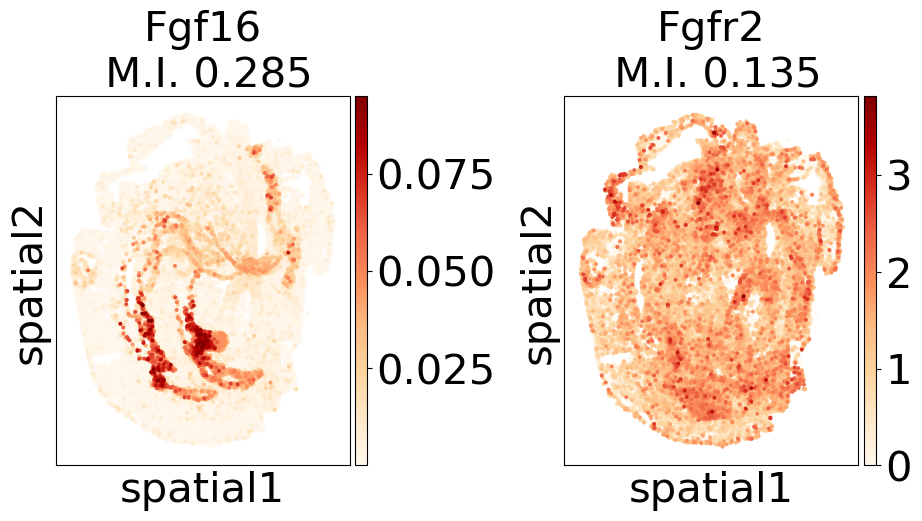

In [20]:
plot_genes(['Fgf16','Fgfr2'], merged_adata2, is_I=True)

              I  pval_norm  var_norm  pval_norm_fdr_bh
Fn1    0.360277        0.0  0.000006               NaN
Itga3  0.141160        0.0  0.000006               NaN


<Figure size 7600x7600 with 0 Axes>

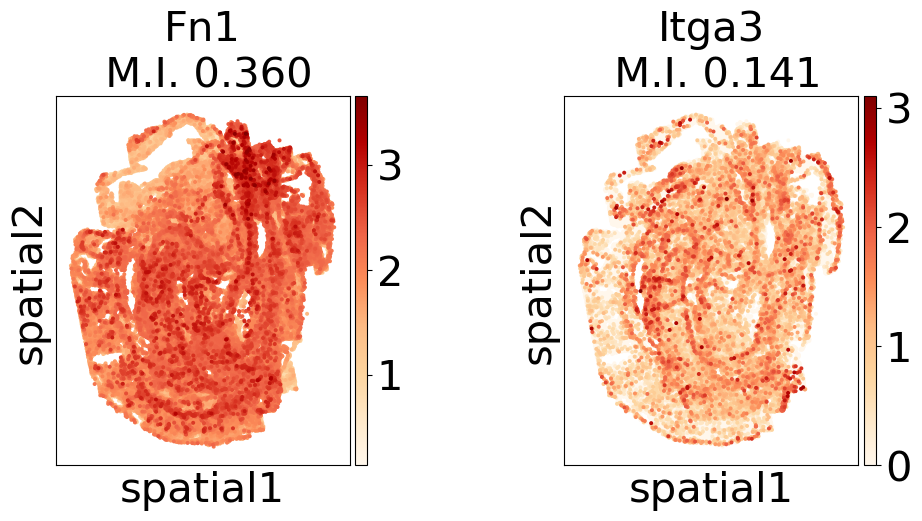

In [21]:
plot_genes(['Fn1','Itga3'], merged_adata2, is_I=True)

              I  pval_norm  var_norm  pval_norm_fdr_bh
Efna1  0.258315        0.0  0.000006               NaN
Epha1  0.269810        0.0  0.000006               NaN


<Figure size 7600x7600 with 0 Axes>

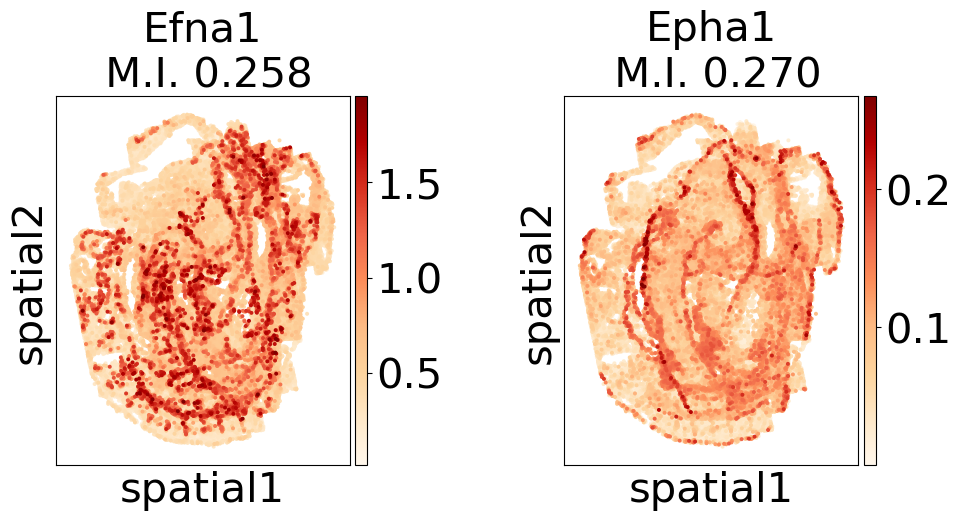

In [22]:
plot_genes(['Efna1','Epha1'], merged_adata2, is_I=True)	

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
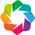

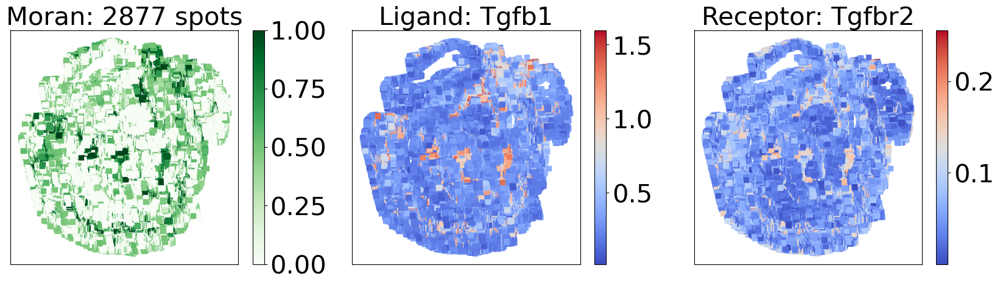

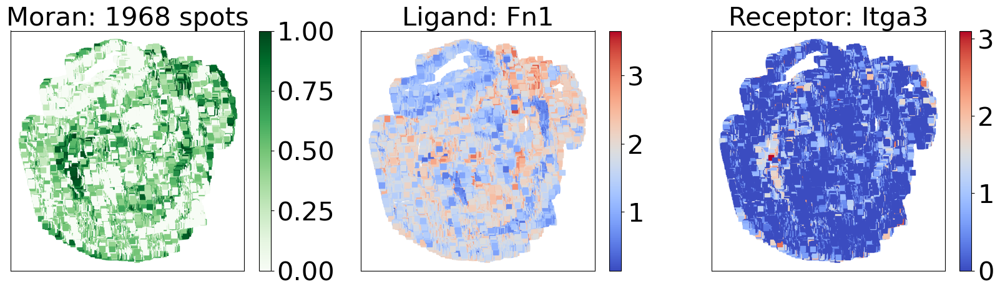

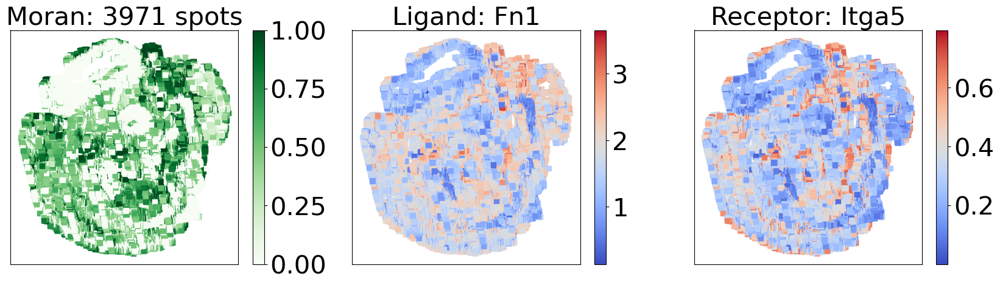

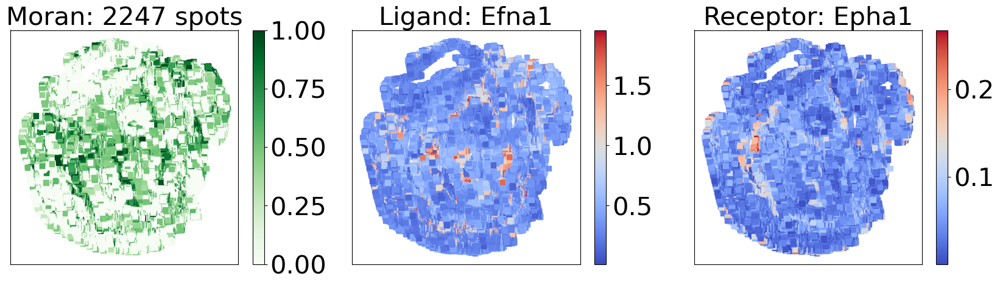

In [23]:
from spatialdm import plottings as sdmplt
merged_adata2.raw = merged_adata2
sdm.spatialdm_local(merged_adata2, method='z-score', specified_ind=None, nproc=1)
sdm.sig_spots(merged_adata2, method='z-score', fdr=False, threshold=0.1) 
# sdmplt.plot_pairs(dict_adata['TransImpSpa'], ['GDF3_ACVR1C_ACVR2A','WNT11_FZD2', 'FGF17_FGFR1'], marker='s')
sdmplt.plot_pairs(merged_adata2, ['TGFB1_ACVR1C_TGFBR2', 'FN1_ITGA3_ITGB1', 'FN1_ITGA5_ITGB1', 'EFNA1_EPHA1'], marker='s')

In [24]:
ratio_imp = []
for jth_ct in range(len(merged_adata.uns['rank_genes_groups']['names'][0])):
    imp_counter = 0
    for ith in range(25):
        # print(merged_adata.uns['rank_genes_groups']['names'][ith][jth_ct])
        # raise
        if merged_adata.uns['rank_genes_groups']['names'][ith][jth_ct].endswith("_imp"):
            imp_counter += 1
    ratio_imp.append(imp_counter / 25)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23]),
 [Text(0, 0, 'Allantois'),
  Text(1, 0, 'Anterior somitic tissues'),
  Text(2, 0, 'Blood progenitors'),
  Text(3, 0, 'Cardiomyocytes'),
  Text(4, 0, 'Cranial mesoderm'),
  Text(5, 0, 'Definitive endoderm'),
  Text(6, 0, 'Dermomyotome'),
  Text(7, 0, 'Endothelium'),
  Text(8, 0, 'Erythroid'),
  Text(9, 0, 'ExE endoderm'),
  Text(10, 0, 'Forebrain/Midbrain/Hindbrain'),
  Text(11, 0, 'Gut tube'),
  Text(12, 0, 'Haematoendothelial progenitors'),
  Text(13, 0, 'Intermediate mesoderm'),
  Text(14, 0, 'Lateral plate mesoderm'),
  Text(15, 0, 'Low quality'),
  Text(16, 0, 'Mixed mesenchymal mesoderm'),
  Text(17, 0, 'NMP'),
  Text(18, 0, 'Neural crest'),
  Text(19, 0, 'Presomitic mesoderm'),
  Text(20, 0, 'Sclerotome'),
  Text(21, 0, 'Spinal cord'),
  Text(22, 0, 'Splanchnic mesoderm'),
  Text(23, 0, 'Surface ectoderm')])

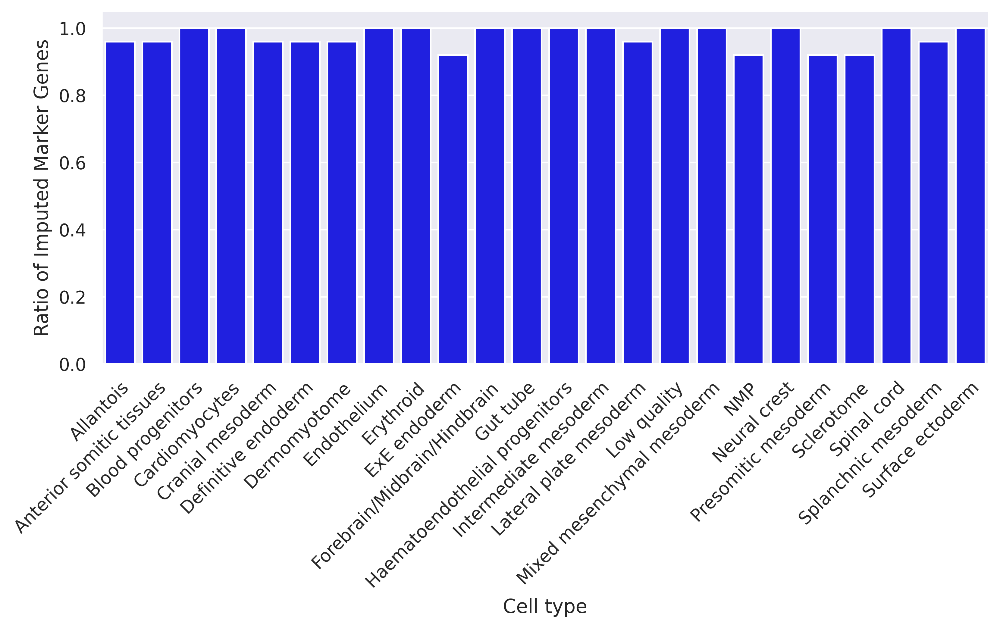

In [25]:
import seaborn as sns
sns.set(rc={'figure.figsize':(10,4), 'figure.dpi':380})

sns.barplot(x=pd.Series(np.unique(merged_adata.obs.celltype_mapped_refined), name='Cell type'), color='blue', y=pd.Series(ratio_imp, name="Ratio of Imputed Marker Genes"))
plt.xticks(rotation=45, ha='right', rotation_mode='anchor')

In [26]:
from sklearn.preprocessing import StandardScaler
from matplotlib import pyplot as plt
def plot(genes, spa_adata, n_cols=5, figsize=(20, 20), dpi=100):
    genes = list(set(list(genes)))
    sns.set(rc={'figure.figsize':figsize, 'figure.dpi': dpi})
    plt.rcParams.update({"font.size":30, 'axes.titlesize':30})
    pre_exprs = [spa_adata[:, gene].X.toarray().flatten() for gene in set(list(genes))]
    exprs = []
    for expr in pre_exprs:
        qt = np.quantile(expr, 0.1)
        expr[expr < qt] = qt
        # qt = np.quantile(expr, 0.85)
        # expr[expr > qt] = qt
        exprs.append(expr)
    titles = [f"{gene}\n M.I. {spa_adata.uns['moranI'].loc[gene].I:.3f}" for gene in genes]
    # sc.pl.spatial(spa_adata, color=[gene], spot_size=0.1, title='Truth')
    
    
    tmp_adata = sc.AnnData(np.array(exprs).T)
    print(tmp_adata)
    tmp_adata.var_names = titles
    tmp_adata.obsm['spatial'] = spa_adata.obsm['spatial'].copy()
    sc.pl.spatial(tmp_adata, color=titles, spot_size=0.1, title=titles, color_map='OrRd', legend_fontsize=10, wspace=0.00001, hspace=0.5, ncols=n_cols)
    

In [27]:
plot(list(merged_adata.uns['rank_genes_groups']['names'][0]), merged_adata, n_cols=8, figsize=(6,6), dpi=350)

AnnData object with n_obs × n_vars = 57536 × 23


In [28]:
merged_adata2.uns['global_res'].loc[unprobed_pairs].selected.sum()

45